In [1]:
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../../"))

In [2]:
from desc import set_device
set_device("gpu")

In [2]:
import numpy as np
np.set_printoptions(linewidth=np.inf, precision=4, suppress=True, threshold=sys.maxsize)
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go
import functools
import scipy

In [3]:
import desc

from desc.basis import *
from desc.backend import *
from desc.compute import *
from desc.coils import *
from desc.equilibrium import *
from desc.examples import *
from desc.grid import *
from desc.geometry import *

from desc.objectives import *
from desc.objectives.objective_funs import *
from desc.objectives.getters import *
from desc.objectives.normalization import compute_scaling_factors
from desc.objectives.utils import *
from desc.optimize._constraint_wrappers import *

from desc.transform import Transform
from desc.plotting import *
from desc.optimize import *
from desc.perturbations import *
from desc.profiles import *
from desc.compat import *
from desc.utils import *
from desc.magnetic_fields import *

from desc.__main__ import main
from desc.vmec_utils import vmec_boundary_subspace
from desc.input_reader import InputReader
from desc.continuation import solve_continuation_automatic

print_backend_info()

DESC version=0.14.1+371.g6a626f49a.
Using JAX backend: jax version=0.5.0, jaxlib version=0.5.0, dtype=float64.
Using device: CPU, with 2.00 GB available memory.


In [5]:
# eq = get("ESTELL")
eq = desc.io.load("isl_curr_dens_output.h5")

In [6]:
plot_3d(eq, "|B|")

In [ ]:
coilfile = "../../SurfaceIntegral/Giuliani.is.free.0403.3.00050.coils"
coils = MixedCoilSet.from_makegrid_coilfile(coilfile)
c_four = coils.to_FourierXYZ(N=100)

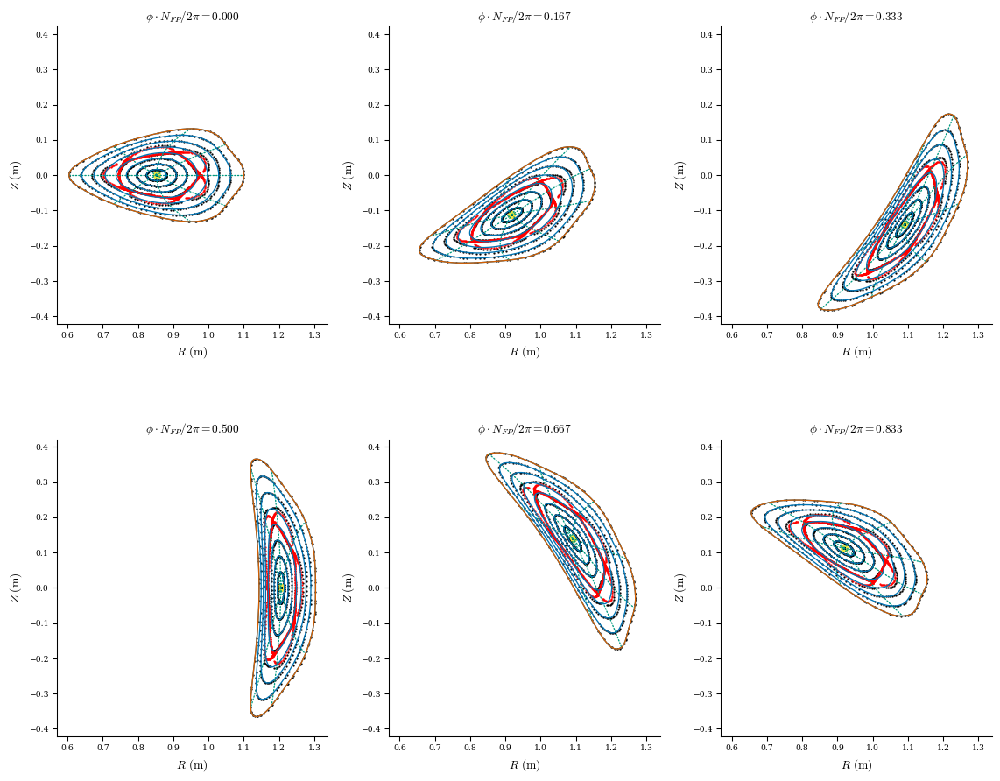

In [24]:
def plot_field_lines(field, eq):
    # for starting locations we'll pick positions on flux surfaces on the outboard midplane
    # grid_trace = LinearGrid(rho=np.linspace(0.4, 0.9, 7))
    grid_trace = LinearGrid(rho=np.linspace(0, 1, 9))
    r0 = eq.compute("R", grid=grid_trace)["R"]
    z0 = eq.compute("Z", grid=grid_trace)["Z"]
    fig, ax = desc.plotting.plot_surfaces(eq)
    fig, ax = desc.plotting.poincare_plot(
        field,
        r0,
        z0,
        NFP=eq.NFP,
        ax=ax,
        color="k",
        size=0.5,
        ntransit=100
    )
    grid_trace2 = LinearGrid(rho=np.linspace(0.52, 0.55, 4))
    r0 = eq.compute("R", grid=grid_trace2)["R"]
    z0 = eq.compute("Z", grid=grid_trace2)["Z"]
    fig, ax = desc.plotting.poincare_plot(
        field, r0, z0, NFP=eq.NFP, ax=ax, color="r", size=0.5, ntransit=250
    )
    return fig, ax


fig, ax = plot_field_lines(c_four, eq);
plt.show()
fig.savefig("islands-before-poincare2.png", dpi=1500)

In [9]:
from desc.objectives.getters import *
from desc.objectives import *
def solve_poincare(eq2solve, fix_lambda=True, **kwargs):
    jac_chunk_size = kwargs.pop("jac_chunk_size", None)
    constraints = get_fixed_xsection_constraints(eq2solve, fix_lambda=fix_lambda)
    objective = ObjectiveFunction(ForceBalance(eq2solve, jac_chunk_size=jac_chunk_size))
    eq2solve.solve(constraints=constraints, objective=objective, verbose=3, **kwargs)

def solve_fixed(eq2solve, **kwargs):
    jac_chunk_size = kwargs.pop("jac_chunk_size", None)
    constraints = get_fixed_boundary_constraints(eq2solve)
    objective = ObjectiveFunction(ForceBalance(eq2solve, jac_chunk_size=jac_chunk_size))
    eq2solve.solve(constraints=constraints, objective=objective, verbose=3, **kwargs)

In [10]:
eq_fixed = eq.copy()
eq_fixed.change_resolution(N=8, N_grid=12)
solve_fixed(eq_fixed, maxiter=100, ftol=4e-3)
eq_fixed._xsection = eq_fixed.get_surface_at(zeta=0)

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 634 ms
Timer: Objective build = 1.04 sec
Building objective: fixed LCFS R
Building objective: fixed LCFS Z
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: self_consistency lcfs R
Building objective: self_consistency lcfs Z
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Timer: Objective build = 597 ms
Timer: LinearConstraintProjection build = 5.36 sec
Number of parameters: 3336
Number of objectives: 11250
Timer: Initializing the optimization = 7.62 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          8.915e-04                                    2.001e-02   
       1              4          6.536e-05     

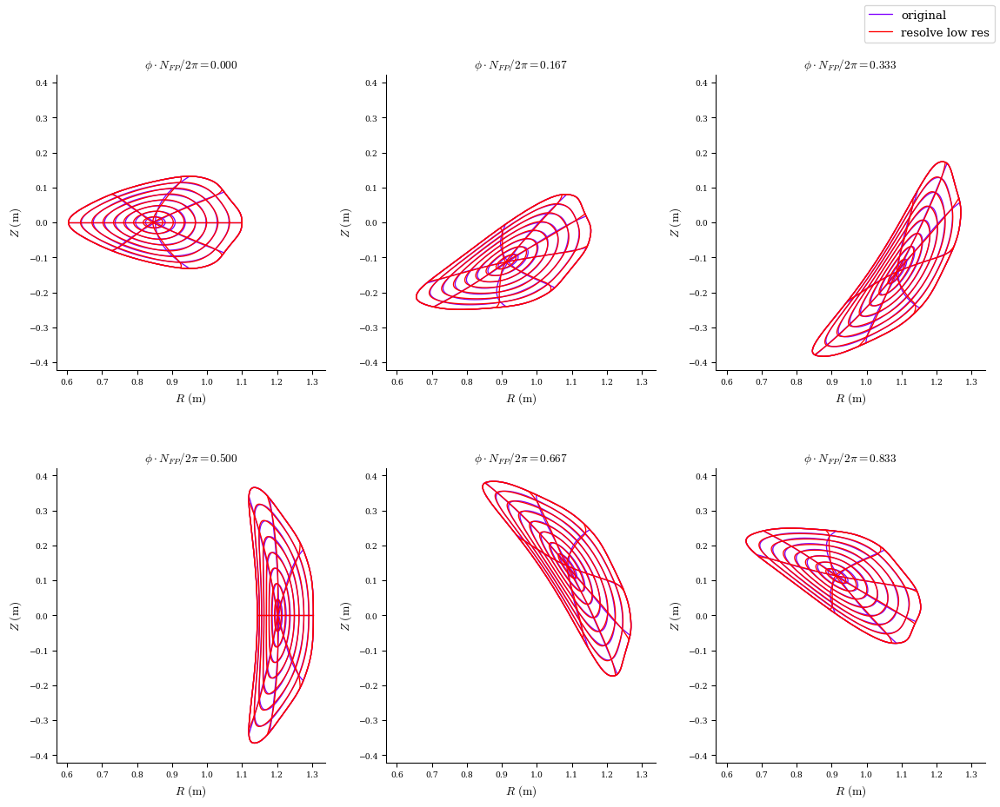

In [11]:
plot_comparison(eqs=[eq, eq_fixed], labels=["original", "resolve low res"]);

In [12]:
eq_fixed._xsection = eq_fixed.get_surface_at(zeta=0)
eq_poin = eq_fixed.copy()
solve_poincare(eq_poin, maxiter=100, ftol=1e-4)
eq_poin.surface = eq_poin.get_surface_at(rho=1)

Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 80.6 ms
Timer: Objective build = 106 ms
Building objective: fixed cross-section R
Building objective: fixed cross-section Z
Building objective: fixed cross-section λ
Building objective: fixed Psi
Building objective: fixed pressure
Building objective: fixed current
Building objective: fixed sheet current
Building objective: lambda gauge
Building objective: self_consistency axis R
Building objective: self_consistency axis Z
Building objective: self_consistency section R
Building objective: self_consistency section Z
Building objective: self_consistency section λ
Timer: Objective build = 478 ms
Timer: LinearConstraintProjection build = 3.90 sec
Number of parameters: 3672
Number of objectives: 11250
Timer: Initializing the optimization = 5.01 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1   

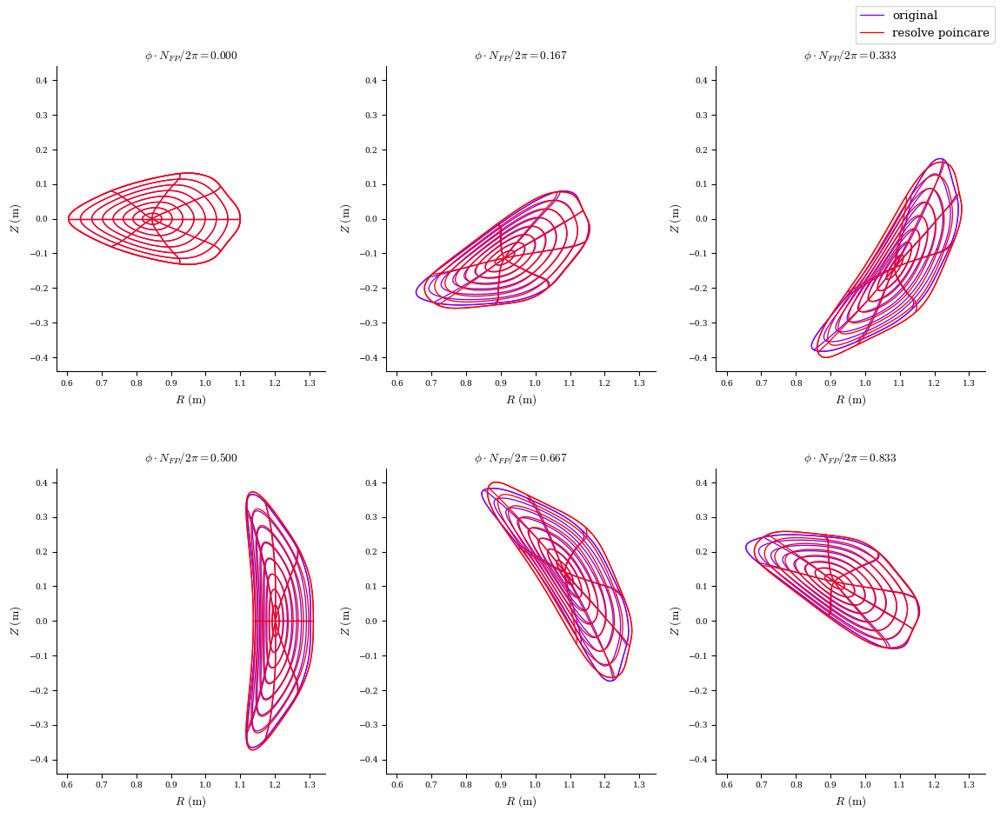

In [13]:
plot_comparison(eqs=[eq_fixed, eq_poin], labels=["original", "resolve poincare"]);

In [14]:
coilset = initialize_modular_coils(eq_poin, num_coils=6, r_over_a=3.0).to_FourierXYZ()
# number of points used to discretize coils. This could be different for each objective
# (eg if you want higher resolution for some calculations), but we'll use the same for all of them
coil_grid = LinearGrid(N=50)
# similarly define a grid on the plasma surface where B*n errors will be evaluated
plasma_grid = LinearGrid(M=25, N=25, NFP=eq_poin.NFP, sym=eq_poin.sym)
plot_grid = LinearGrid(M=20, N=40, NFP=1, endpoint=True)
fig = plot_3d(eq_poin,"|B|")
fig = plot_coils(coilset, fig=fig)
fig.show()

In [15]:
# define our objective function (we will use a helper function here to make it easier to change weights later)
weights = {
    "quadratic flux": 300,
    "coil-coil min dist": 100,
    "plasma-coil min dist": 10,
    "coil curvature": 750,
    "coil length": 20,
}

def make_vac_coil_obj(eq, coilset, weights_dict):
    obj = ObjectiveFunction(
        (
            QuadraticFlux(
                eq,
                field=coilset,
                # grid of points on plasma surface to evaluate normal field error
                eval_grid=plasma_grid,
                field_grid=coil_grid,
                vacuum=True,  # vacuum=True means we won't calculate the plasma contribution to B as it is zero
                weight=weights_dict["quadratic flux"],
                bs_chunk_size=10,
            ),
            CoilCurvature(
                coilset,
                bounds=(-1, 2),
                normalize_target=False,  # we're giving bounds in normalized units
                grid=coil_grid,
                weight=weights_dict["coil curvature"],
            ),
            CoilLength(
                coilset,
                bounds=(0, 2 * np.pi * (coilset[0].compute("length")["length"])),
                normalize_target=True,  # target length is in meters, not normalized
                grid=coil_grid,
                weight=weights_dict["coil length"],
            ),
        )
    )
    return obj


obj = make_vac_coil_obj(eq_poin, coilset, weights)
coil_indices_to_fix_current = [False for c in coilset]
coil_indices_to_fix_current[0] = True
constraints = (FixCoilCurrent(coilset, indices=coil_indices_to_fix_current),)

optimizer = Optimizer("lsq-exact")

(optimized_coilset,), _ = optimizer.optimize(
    coilset,
    objective=obj,
    constraints=constraints,
    maxiter=100,
    verbose=3,
    ftol=1e-6,
    xtol=0,
    copy=True,
)

Building objective: Quadratic flux
Precomputing transforms
Timer: Precomputing transforms = 1.09 sec
Building objective: coil curvature
Precomputing transforms
Timer: Precomputing transforms = 124 ms
Building objective: coil length
Precomputing transforms
Timer: Precomputing transforms = 3.49 ms
Timer: Objective build = 1.89 sec
Building objective: fixed coil current
Building objective: fixed shift
Building objective: fixed rotation
Timer: Objective build = 299 ms
Timer: LinearConstraintProjection build = 2.20 sec
Number of parameters: 383
Number of objectives: 1938
Timer: Initializing the optimization = 4.47 sec

Starting optimization
Using method: lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1          7.460e+06                                    2.399e+03   
       1              7          7.439e+06      2.012e+04      6.687e-03      2.391e+03   
       2              8          7.403e+06      3.650e+04  

In [16]:
eq_poin.surface = eq_poin.get_surface_at(rho=1.)
fig = plot_3d(
    eq_poin.surface, "B*n", field=optimized_coilset, field_grid=coil_grid, grid=plot_grid
)

fig = plot_coils(optimized_coilset, fig=fig)
fig.show()

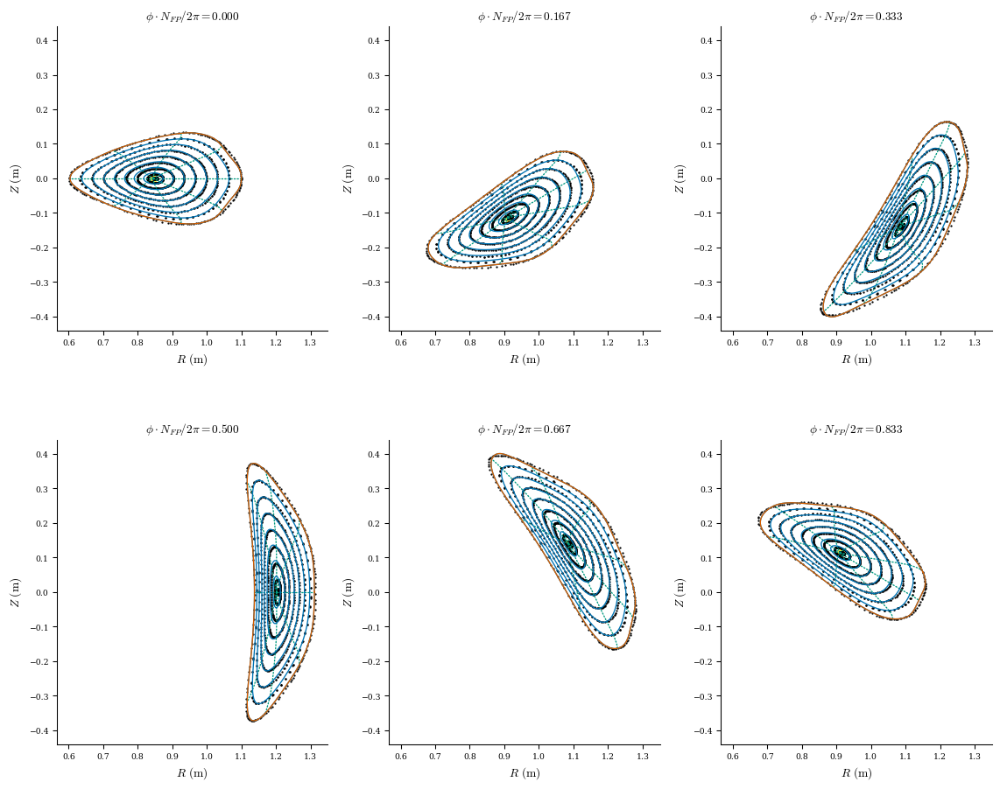

In [22]:
def plot_field_lines(field, eq):
    # for starting locations we'll pick positions on flux surfaces on the outboard midplane
    grid_trace = LinearGrid(rho=np.linspace(0, 1, 9))
    r0 = eq.compute("R", grid=grid_trace)["R"]
    z0 = eq.compute("Z", grid=grid_trace)["Z"]
    fig, ax = desc.plotting.plot_surfaces(eq)
    fig, ax = desc.plotting.poincare_plot(
        field,
        r0,
        z0,
        NFP=eq.NFP,
        ax=ax,
        color="k",
        size=0.5,
        ntransit = 150,
    )
    # grid_trace2 = LinearGrid(rho=[0.95, 1.])
    # r0 = eq.compute("R", grid=grid_trace2)["R"]
    # z0 = eq.compute("Z", grid=grid_trace2)["Z"]
    # fig, ax = desc.plotting.poincare_plot(
    #     field, r0, z0, NFP=eq.NFP, ax=ax, color="r", size=0.5, ntransit=200
    # )
    return fig, ax

from desc.plotting import poincare_plot
fig, ax = plot_field_lines(optimized_coilset, eq_poin)
plt.show()
fig.savefig("islands-after-poincare2.png", dpi=1500)

Text(0.5, 1.0, 'After Poincare')

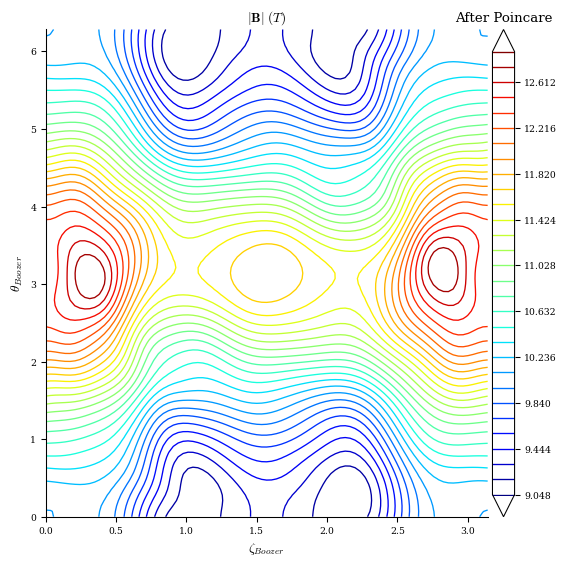

In [18]:
plot_boozer_surface(eq_poin)
plt.title("After Poincare")

Text(0.5, 1.0, 'Original')

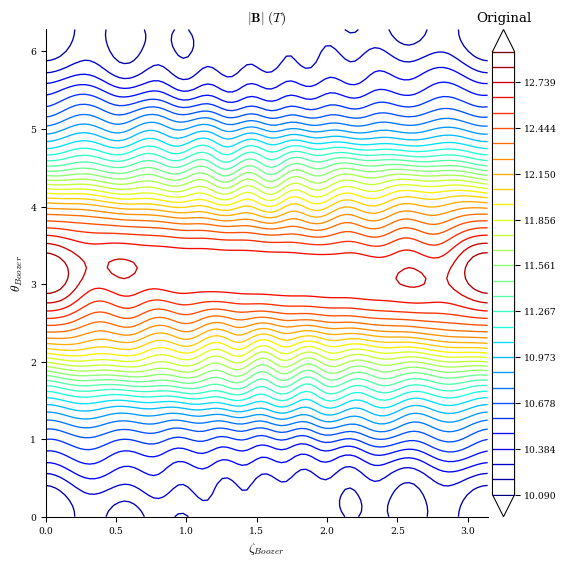

In [19]:
plot_boozer_surface(eq)
plt.title("Original")

Text(0.5, 1.0, 'Original')

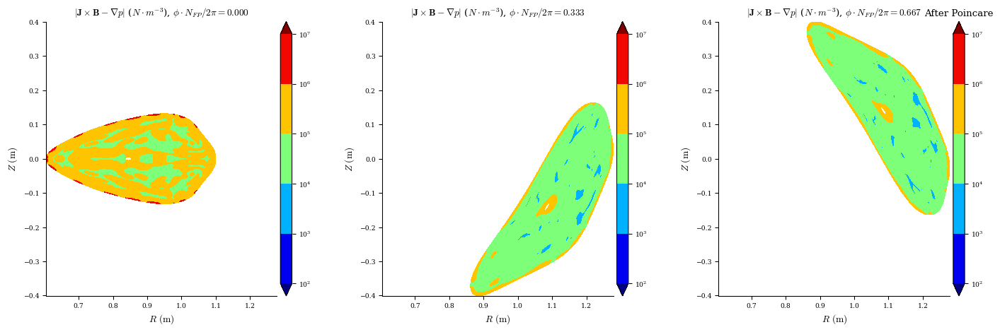

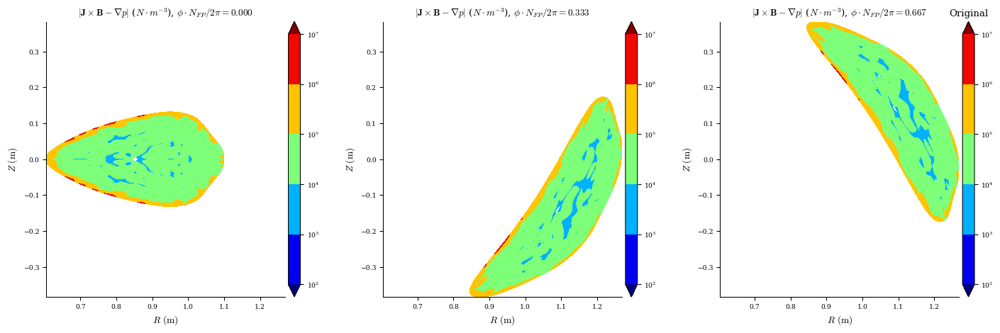

In [20]:
plot_section(eq_poin, "|F|", phi=3, log=True);
plt.title("After Poincare")
plot_section(eq, "|F|", phi=3, log=True);
plt.title("Original")

In [6]:
eq

Equilibrium at 0x7fee0ab3a4b0 (L=16, M=16, N=16, NFP=2, sym=1, spectral_indexing=ansi, vacuum=True, profile='current')

(<Figure size 384.108x384.108 with 1 Axes>,
 <Axes: xlabel='$\\rho$', ylabel='$ \\iota ~(~)$'>)

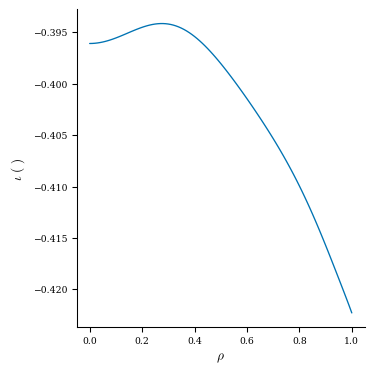

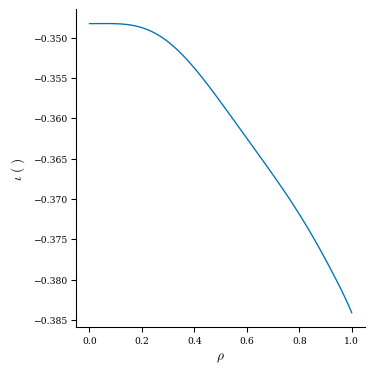

In [6]:
plot_1d(eq_low, "iota")
plot_1d(eq_poin, "iota")

In [4]:
eq_poin = desc.io.load("poin_isl_curr_dens_output.h5")
eq_low = desc.io.load("low_res_isl_curr_dens_output.h5")

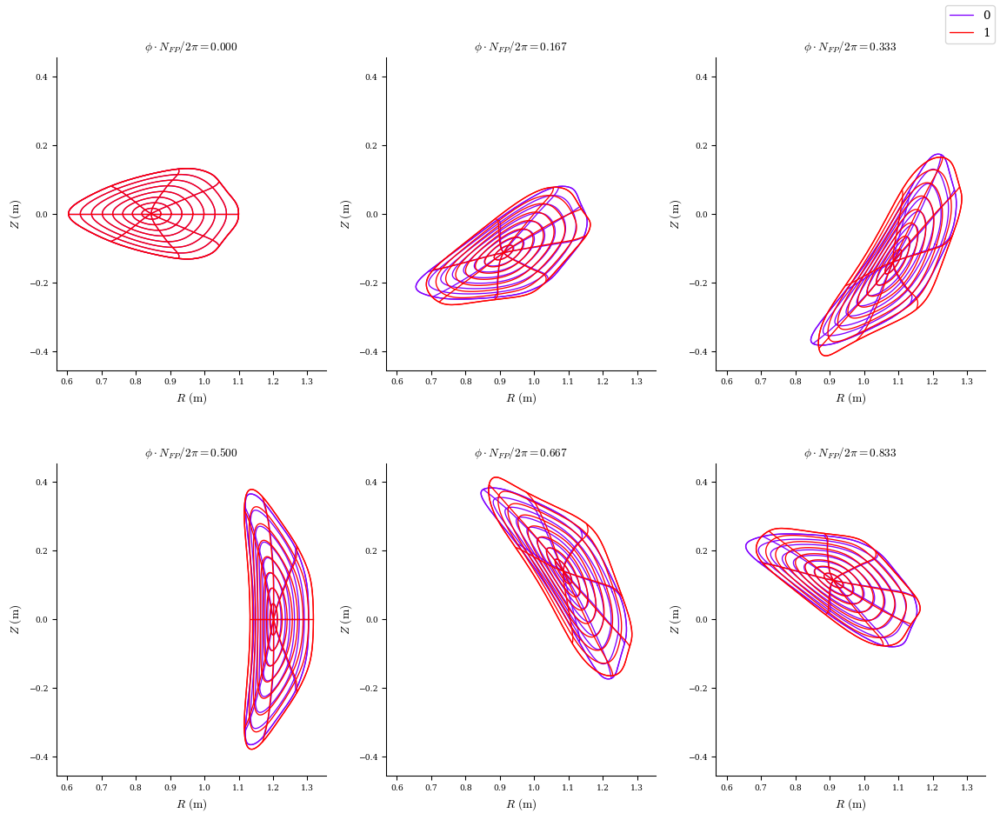

In [5]:
plot_comparison([eq_low, eq_poin]);